### This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
imp

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

In [27]:
library(ggplot2)
library(highcharter)
library(GGally)
library(tidytext)
library(plotly)
library(janitor)
library(tidyverse)

In [28]:
df <- read_csv("../input/pokemon/Pokemon.csv")%>%clean_names()


── Column specification ────────────────────────────────────────────────────────
cols(
  `#` = col_double(),
  Name = col_character(),
  `Type 1` = col_character(),
  `Type 2` = col_character(),
  Total = col_double(),
  HP = col_double(),
  Attack = col_double(),
  Defense = col_double(),
  `Sp. Atk` = col_double(),
  `Sp. Def` = col_double(),
  Speed = col_double(),
  Generation = col_double(),
  Legendary = col_logical()
)




In [29]:
df %>% head(5)

number,name,type_1,type_2,total,hp,attack,defense,sp_atk,sp_def,speed,generation,legendary
<dbl>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<lgl>
1,Bulbasaur,Grass,Poison,318,45,49,49,65,65,45,1,FALSE
2,Ivysaur,Grass,Poison,405,60,62,63,80,80,60,1,FALSE
3,Venusaur,Grass,Poison,525,80,82,83,100,100,80,1,FALSE
3,VenusaurMega Venusaur,Grass,Poison,625,80,100,123,122,120,80,1,FALSE
4,Charmander,Fire,NA,309,39,52,43,60,50,65,1,FALSE


In [30]:
summary(df)

     number          name              type_1             type_2         
 Min.   :  1.0   Length:800         Length:800         Length:800        
 1st Qu.:184.8   Class :character   Class :character   Class :character  
 Median :364.5   Mode  :character   Mode  :character   Mode  :character  
 Mean   :362.8                                                           
 3rd Qu.:539.2                                                           
 Max.   :721.0                                                           
     total             hp             attack       defense      
 Min.   :180.0   Min.   :  1.00   Min.   :  5   Min.   :  5.00  
 1st Qu.:330.0   1st Qu.: 50.00   1st Qu.: 55   1st Qu.: 50.00  
 Median :450.0   Median : 65.00   Median : 75   Median : 70.00  
 Mean   :435.1   Mean   : 69.26   Mean   : 79   Mean   : 73.84  
 3rd Qu.:515.0   3rd Qu.: 80.00   3rd Qu.:100   3rd Qu.: 90.00  
 Max.   :780.0   Max.   :255.00   Max.   :190   Max.   :230.00  
     sp_atk           sp_de

In [31]:
colSums(is.na(df))

number       name     type_1     type_2      total         hp     attack 
         0          0          0        386          0          0          0 
   defense     sp_atk     sp_def      speed generation  legendary 
         0          0          0          0          0          0

In [32]:
df %>% group_by(type_1) %>% summarise(total=n())%>% data.frame()

type_1,total
<chr>,<int>
Bug,69
Dark,31
Dragon,32
Electric,44
Fairy,17
Fighting,27
Fire,52
Flying,4
Ghost,32


In [33]:
df %>% group_by(type_2) %>% summarise(total=n())%>% data.frame()

type_2,total
<chr>,<int>
Bug,3
Dark,20
Dragon,18
Electric,6
Fairy,23
Fighting,26
Fire,12
Flying,97
Ghost,14


In [34]:
df %>% group_by(generation) %>% summarise(total=n())%>% data.frame()

generation,total
<dbl>,<int>
1,166
2,106
3,160
4,121
5,165
6,82


In [35]:
#top 10 pokemons with high hp
df %>% group_by(name,hp)%>% arrange(desc(hp)) %>% ungroup()  %>%
select("name","type_1","hp")%>%head(10)%>% data.frame()

name,type_1,hp
<chr>,<chr>,<dbl>
Blissey,Normal,255
Chansey,Normal,250
Wobbuffet,Psychic,190
Wailord,Water,170
Alomomola,Water,165
Snorlax,Normal,160
Slaking,Normal,150
Drifblim,Ghost,150
GiratinaAltered Forme,Ghost,150


In [36]:
#top 10 pokemons with high attack
df %>% group_by(name,attack)%>% arrange(desc(attack)) %>% ungroup() %>%
select("name","type_1","attack")%>%head(10)%>% data.frame()

name,type_1,attack
<chr>,<chr>,<dbl>
MewtwoMega Mewtwo X,Psychic,190
HeracrossMega Heracross,Bug,185
GroudonPrimal Groudon,Ground,180
RayquazaMega Rayquaza,Dragon,180
DeoxysAttack Forme,Psychic,180
GarchompMega Garchomp,Dragon,170
KyuremBlack Kyurem,Dragon,170
BanetteMega Banette,Ghost,165
Rampardos,Rock,165


In [37]:
#top 10 pokemons with high defense
df %>% group_by(name,defense)%>% arrange(desc(defense)) %>% ungroup()  %>%
select("name","type_1","defense")%>%head(10)%>% data.frame()

name,type_1,defense
<chr>,<chr>,<dbl>
SteelixMega Steelix,Steel,230
Shuckle,Bug,230
AggronMega Aggron,Steel,230
Steelix,Steel,200
Regirock,Rock,200
Avalugg,Ice,184
SlowbroMega Slowbro,Water,180
Cloyster,Water,180
Aggron,Steel,180


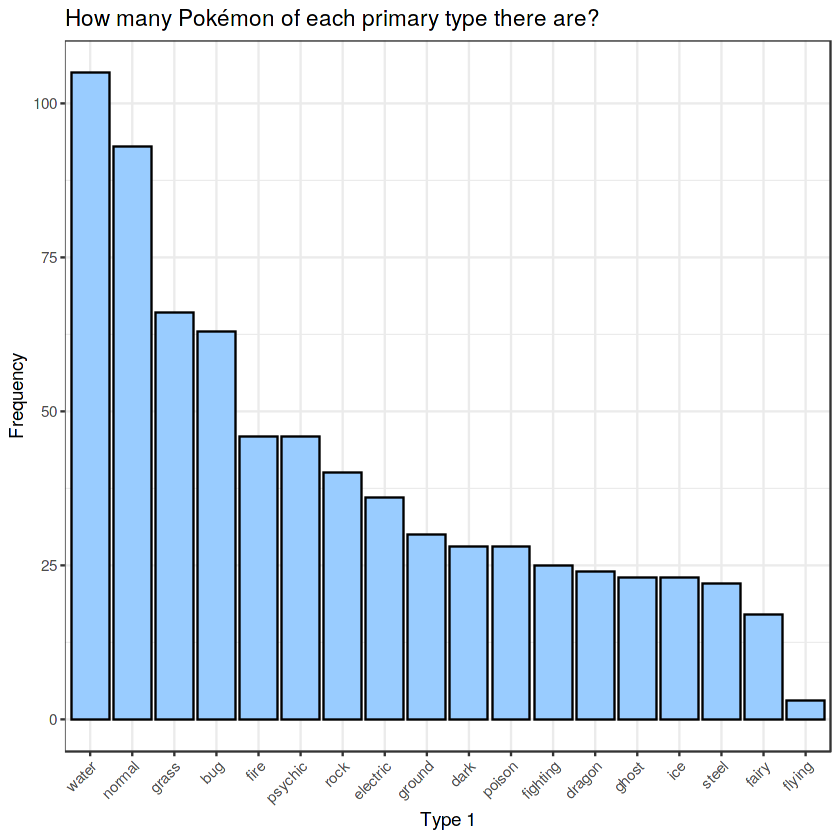

In [38]:
#number of primary pokemons
ggplot(pokemon, aes(x=fct_infreq(type_1))) + 
  geom_bar(fill="#99CCFF", colour="black") +
  labs(x="Type 1", y="Frequency",
       title="How many Pokémon of each primary type there are?") +
  theme_bw() +
  theme(axis.text.x=element_text(angle=45, hjust=1))

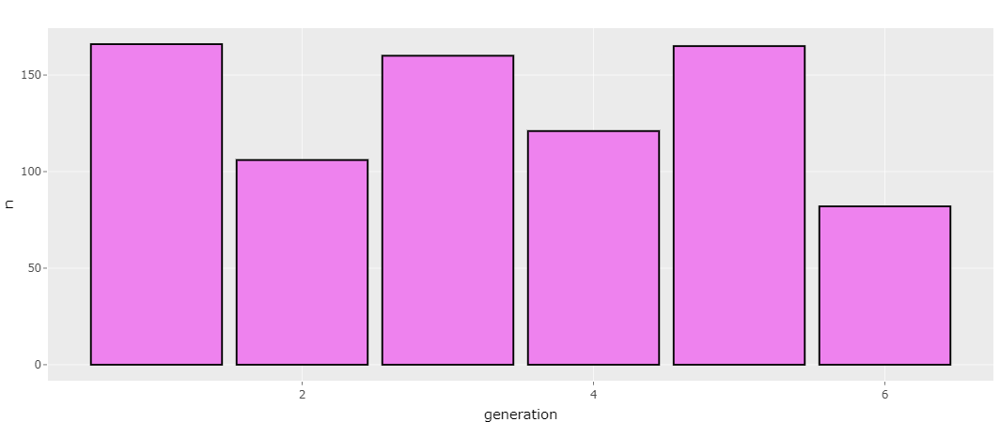

In [39]:
#number of pokemons per generation
ggplotly(df%>% group_by(generation) %>% count()%>% ggplot(aes(generation,n))+geom_bar(stat = "identity",color="black",fill="violet"))

In [40]:
#distribution of defense with type-1 Pokemons
hcboxplot(x=df$defense,var=df$type_1,color="yellow") %>%
  hc_add_theme(hc_theme_darkunica())%>%hc_chart(type = "column")

Warning message:
“`cols` is now required when using unnest().
Please use `cols = c(data)`”


HTML widgets cannot be represented in plain text (need html)

In [41]:
hcboxplot(x=df$hp,var=df$type_1,color="white") %>%
  hc_add_theme(hc_theme_darkunica())%>%hc_chart(type = "column")

Warning message:
“`cols` is now required when using unnest().
Please use `cols = c(data)`”


HTML widgets cannot be represented in plain text (need html)

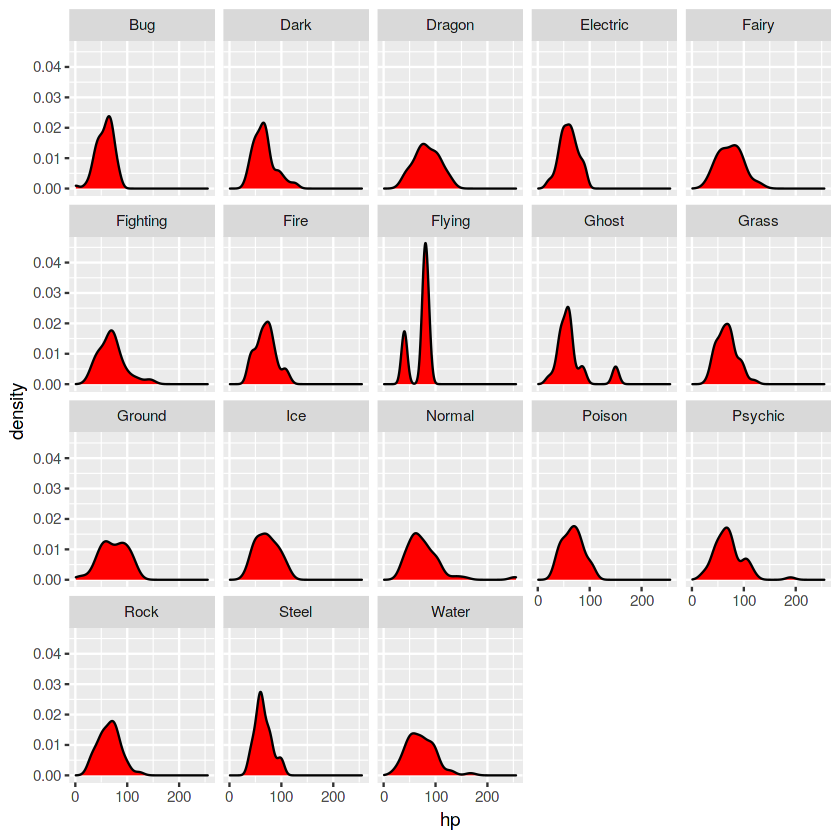

In [42]:
ggplot(df,aes(hp))+geom_density(color="black", fill="red")+facet_wrap(~type_1)

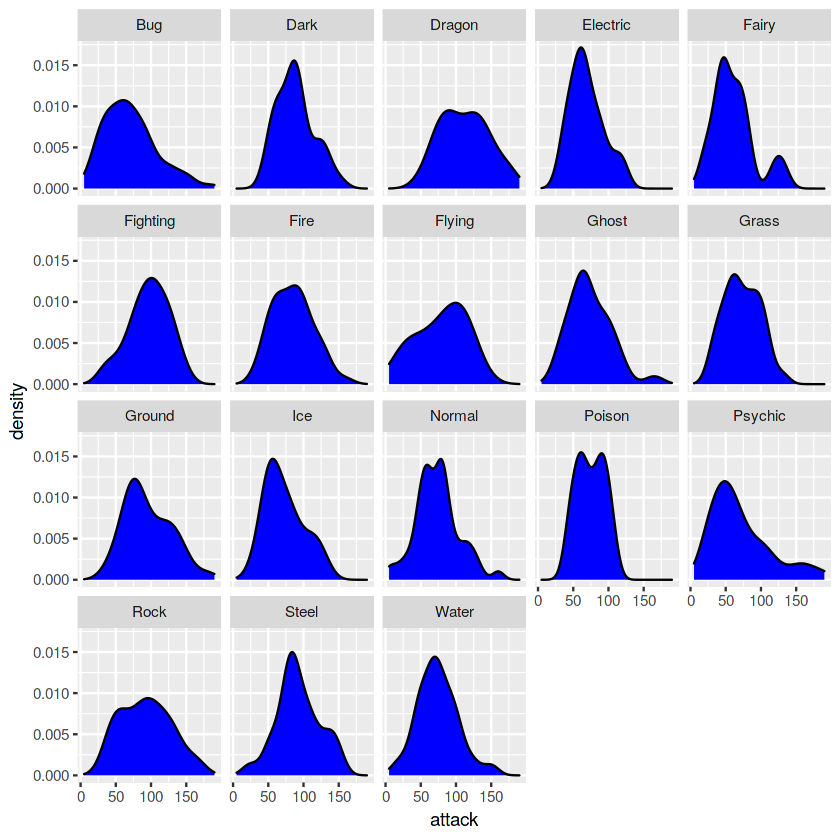

In [43]:
ggplot(df,aes(attack))+geom_density(color="black", fill="blue")+facet_wrap(~type_1)

Warning message:
“`line.width` does not currently support multiple values.”
Warning message:
“`line.width` does not currently support multiple values.”
Warning message in RColorBrewer::brewer.pal(N, "Set2"):
“minimal value for n is 3, returning requested palette with 3 different levels
”
Warning message in RColorBrewer::brewer.pal(N, "Set2"):
“minimal value for n is 3, returning requested palette with 3 different levels
”
Warning message:
“`line.width` does not currently support multiple values.”
Warning message:
“`line.width` does not currently support multiple values.”
Warning message in RColorBrewer::brewer.pal(N, "Set2"):
“minimal value for n is 3, returning requested palette with 3 different levels
”
Warning message in RColorBrewer::brewer.pal(N, "Set2"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


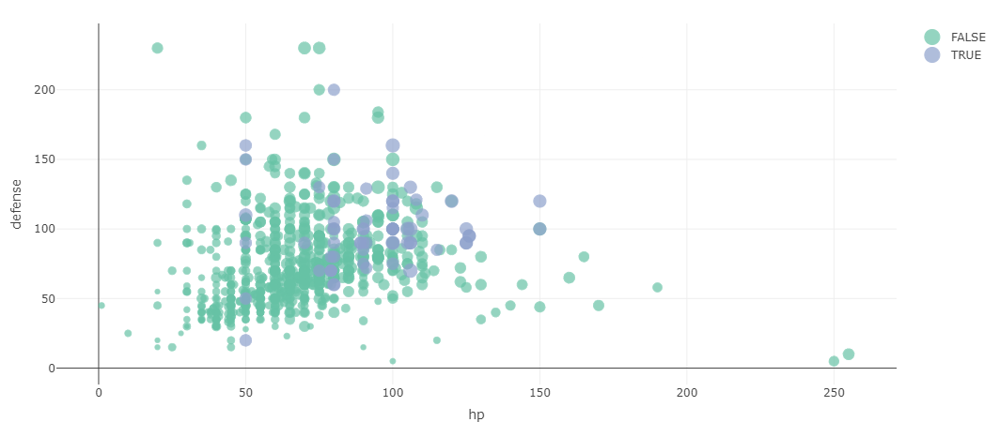

In [44]:
plot_ly(df,x=~hp,y=~defense,type="scatter",mode="markers",size=~total,color = ~legendary,text=~name)

`geom_smooth()` using method = 'loess' and formula 'y ~ x'



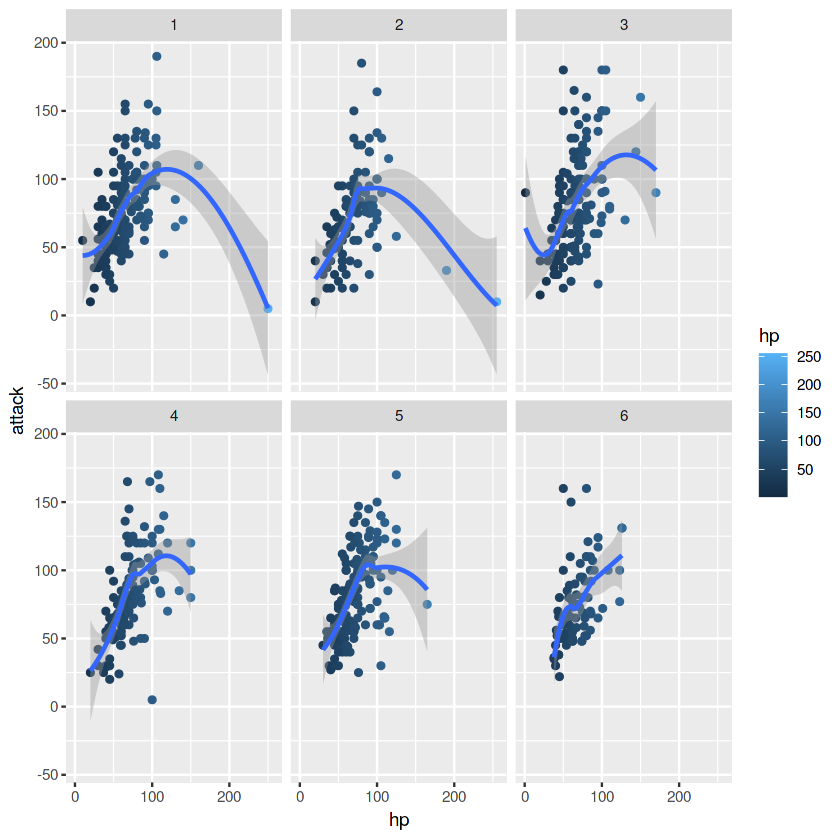

In [45]:
ggplot(df,aes(hp,attack))+geom_point(aes(color=hp))+facet_wrap(~generation)+stat_smooth()


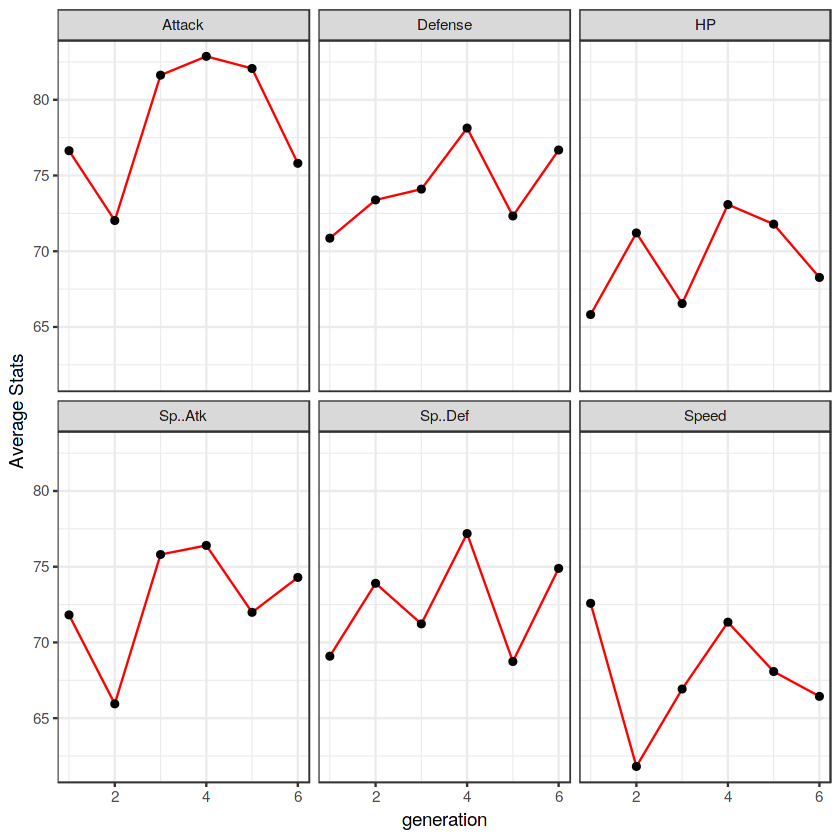

In [46]:
#average statistics of each pokemon
df %>%
  group_by(generation) %>%
  summarize(HP=mean(hp),
            Attack=mean(attack),
            Defense=mean(defense),
            Sp..Atk=mean(sp_atk),
            Sp..Def=mean(sp_def),
            Speed=mean(speed)) %>%
  gather(Stats, value, 2:7) %>%
  ggplot(aes(x=generation, y=value, group=1)) +
    geom_line(colour="red") +
    geom_point() +
    facet_wrap(~Stats) +
    labs(y="Average Stats") +
    theme_bw()

Warning message:
“`line.width` does not currently support multiple values.”
Warning message:
“`line.width` does not currently support multiple values.”
Warning message in RColorBrewer::brewer.pal(N, "Set2"):
“minimal value for n is 3, returning requested palette with 3 different levels
”
Warning message in RColorBrewer::brewer.pal(N, "Set2"):
“minimal value for n is 3, returning requested palette with 3 different levels
”
Warning message:
“`line.width` does not currently support multiple values.”
Warning message:
“`line.width` does not currently support multiple values.”
Warning message in RColorBrewer::brewer.pal(N, "Set2"):
“minimal value for n is 3, returning requested palette with 3 different levels
”
Warning message in RColorBrewer::brewer.pal(N, "Set2"):
“minimal value for n is 3, returning requested palette with 3 different levels
”


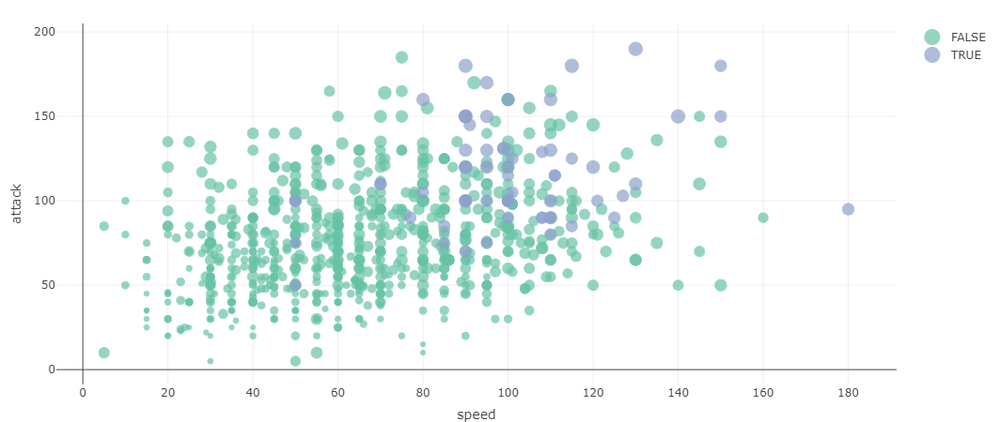

In [47]:
plot_ly(df,x=~speed,y=~attack,type="scatter",mode="markers",size=~total,color = ~legendary,text=~name)

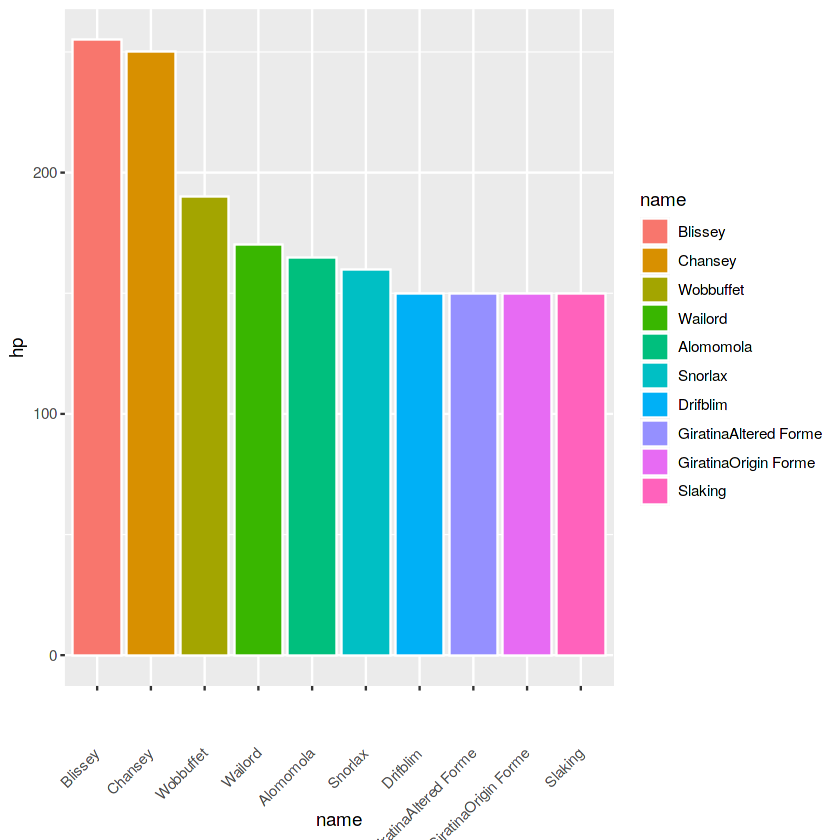

In [48]:
#top-10 pokemons with highest hp
df %>% group_by(hp,name) %>%arrange(desc(hp))%>%
  ungroup()%>% mutate(name=reorder(name,-hp))%>%head(10)%>%
  ggplot(aes(name,hp,fill=name))+geom_bar(stat = "identity",color="white")+theme(axis.text.x = element_text(angle = 45,hjust = 1,vjust = 0.5))

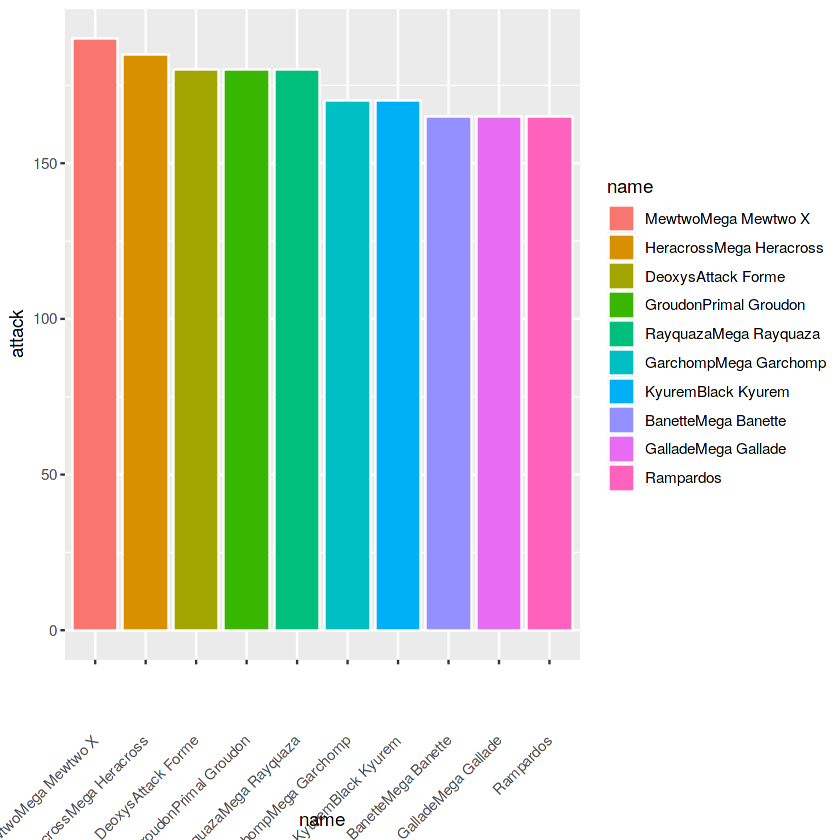

In [49]:
#top-10 pokemons with highest attack
df %>% group_by(attack,name) %>%arrange(desc(attack))%>%
  ungroup()%>% mutate(name=reorder(name,-attack))%>%head(10)%>%
  ggplot(aes(name,attack,fill=name))+geom_bar(stat = "identity",color="white")+theme(axis.text.x = element_text(angle = 45,hjust = 1,vjust = 0.5))

In [50]:
hp1<-ggplotly(df %>% ggplot(aes(hp))+geom_density(fill="black"))
defense1<-ggplotly(df %>% ggplot(aes(defense))+geom_density(fill="green"))
sp_def1<-ggplotly(df %>% ggplot(aes(sp_def))+geom_density(fill="red"))
speed1<-ggplotly(df %>% ggplot(aes(speed))+geom_density(fill="violet"))
attack1<-ggplotly(df %>% ggplot(aes(attack))+geom_density(fill="blue"))
sp_atk1<-ggplotly(df %>% ggplot(aes(sp_atk))+geom_density(fill="yellow"))


subplot(hp1,defense1,sp_def1,speed1,attack1,sp_atk1,nrows = 3)

HTML widgets cannot be represented in plain text (need html)